In [250]:
# Training an Automated Taxi using Reinforcement Learning

print ("I Want to train a taxi agent in the OpenAI Gym Taxi-v3 environment using three (3) Reinforcement Learning algorithms:\n")

print ("1- Random Agent (baseline)\n")
print ("2- Q-Learning\n")
print ("3- SARSA\n")
print ("4- Deep Q-Learning (DQN)\n")

print ("Name: Samuel Olayiwola\n")  
print ("Student Number: E4532321\n")  
print ("Course: Artificial Intelligence Foundation ICA\n")
print ("Course Code: CIS4049-N-BF1\n")
print ("Submission Date: 6th January 2026\n")
print ("Lab Tutor: Aliyu Abubakar\n")


I Want to train a taxi agent in the OpenAI Gym Taxi-v3 environment using three (3) Reinforcement Learning algorithms:

1- Random Agent (baseline)

2- Q-Learning

3- SARSA

4- Deep Q-Learning (DQN)

Name: Samuel Olayiwola

Student Number: E4532321

Course: Artificial Intelligence Foundation ICA

Course Code: CIS4049-N-BF1

Submission Date: 6th January 2026

Lab Tutor: Aliyu Abubakar



### Understanding the Taxi Environment

The Taxi environment is a 5x5 grid world with four designated locations: R(ed), G(reen), B(lue), and Y(ellow). 

## Actions
The taxi can take 6 actions:
- 0: Move south
- 1: Move north
- 2: Move east
- 3: Move west
- 4: Pickup passenger
- 5: Drop off passenger

## Rewards
- -1 for each action
- +20 for successful dropoff
- -10 for illegal pickup/dropoff actions



In [2]:
#Installation of Required Libraries
#!pip install gymnasium
#!pip install torch
#!pip install matplotlib

In [3]:


#Imporrtation of Required Libraries
import warnings
# Suppress pygame/pkg_resources deprecation UserWarning in this notebook environment
warnings.filterwarnings("ignore", category=UserWarning, message="pkg_resources is deprecated as an API.*")

import gymnasium as gym
import numpy as np
import random
import torch
import pygame
from datetime import datetime
from time import sleep
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from collections import deque
import time 


In [4]:
# Create the Taxi-v3 environment with human rendering so we can watch it later
boroTaxiEnvi = gym.make("Taxi-v3", render_mode="ansi")

# Reset the environment to start fresh
state, info = boroTaxiEnvi.reset()
print("Environment created! There are", boroTaxiEnvi.observation_space.n, "possible states")
print("There are", boroTaxiEnvi.action_space.n, "possible actions (0-5)")
print("- 0: Move south")
print("- 1: Move north")
print("- 2: Move east")
print("- 3: Move west")
print("- 4: Pickup passenger")
print("- 5: Drop off passenger")

Environment created! There are 500 possible states
There are 6 possible actions (0-5)
- 0: Move south
- 1: Move north
- 2: Move east
- 3: Move west
- 4: Pickup passenger
- 5: Drop off passenger


In [5]:

taxi_sample_state = [0, 499]

print("Taxi Sample States in Asii Render Mode\n")
print("="*60)


for state in taxi_sample_state:
    boroTaxiEnvi.reset()
    boroTaxiEnvi.unwrapped.s = state                  # force the environment to this exact state
    
    ansi_text = boroTaxiEnvi.render()                  # this returns the colored string
    
    row, col, pass_idx, dest_idx = boroTaxiEnvi.unwrapped.decode(state)
    locations = ['R', 'G', 'Y', 'B']
    passenger = "Inside taxi" if pass_idx == 4 else locations[pass_idx]
    destination = locations[dest_idx]
    
    print(f"STATE {state}")
    print(f"Taxi at ({row},{col}) | Passenger: {passenger} | Goal: {destination}")
    print("-" * 50)
    print(ansi_text)                          # prints the full colored grid
    print("=" * 60)

Taxi Sample States in Asii Render Mode

STATE 0
Taxi at (0,0) | Passenger: R | Goal: R
--------------------------------------------------
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+


STATE 499
Taxi at (4,4) | Passenger: Inside taxi | Goal: B
--------------------------------------------------
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B:_|
+---------+




##### The Output above shows state 0 of the 500 states and the last state which show green and passwnger currently in the taxi

In [6]:
#now I will set a specific initial state for training and testing by indexing the taxi environment rows, columns, passenger locations, and destination locations
starting_state = boroTaxiEnvi.unwrapped.encode(4, 4, 2, 0)
print("Starting State:", starting_state)

Starting State: 488


In [7]:
row, col, pass_idx, dest_idx = boroTaxiEnvi.unwrapped.decode(starting_state)

locations = ['R', 'G', 'Y', 'B']
passenger = "Inside taxi" if pass_idx == 4 else locations[pass_idx]
destination = locations[dest_idx]

# Force environment into that state
boroTaxiEnvi.reset()
boroTaxiEnvi.unwrapped.s = starting_state

# Render (this returns colored ANSI text)
ansi_text = boroTaxiEnvi.render()

# Print
print("Encoded State:", starting_state)
print(f"Decoded as: row={row}, col={col}, passenger={passenger}, destination={destination}")
print("-" * 60)
print(ansi_text)
print("-" * 60)

boroTaxiEnvi.close()

Encoded State: 488
Decoded as: row=4, col=4, passenger=Y, destination=R
------------------------------------------------------------
+---------+
|R: | : :G|
| : | : : |
| : : : : |
| | : | : |
|Y| : |B: |
+---------+


------------------------------------------------------------


In [8]:
print ("structure of the table\n")
print("{action: [(probability, nextstate, reward, done}]")

structure of the table

{action: [(probability, nextstate, reward, done}]


In [9]:
# This helps to Verify that the state was set correctly
boroTaxiEnvi.unwrapped.P[starting_state]


{0: [(1.0, 488, -1, False)],
 1: [(1.0, 388, -1, False)],
 2: [(1.0, 488, -1, False)],
 3: [(1.0, 468, -1, False)],
 4: [(1.0, 488, -10, False)],
 5: [(1.0, 488, -10, False)]}

##### Now I'll test the state of the automated taxi by running it randomly without Reinforcement Learning to see how the timesteps it will take to successfully complete a trip in human render

### To Test this Random Agent from Specific and since i am doing it over 1000 trips. I will run 999 episodes in no render mode and the last episode in human render mode to watch the taxi in action.

In [10]:
MAX_EPISODE_STEPS = 10
EPISODES = 1000

env = gym.make("Taxi-v3", max_episode_steps=MAX_EPISODE_STEPS)
env.close()

starting_state = env.unwrapped.encode(2, 4, 2, 0)
print("Starting state:", starting_state)


Starting state: 288


In [30]:

# Create environments
BoroTaxiNoRender = gym.make("Taxi-v3", max_episode_steps=2000)
BoroTaxiHumanRender = gym.make("Taxi-v3", render_mode="human", max_episode_steps=20) # Also set the maximum steps per episode to 1,000

# Set starting state: row=2, col=4, passenger=2(Y), destination=0(R)
starting_state = BoroTaxiNoRender.unwrapped.encode(2, 4, 2, 0)
print("Starting state:", starting_state)

def run_last_episode_in_human_render(BoroTaxiNoRender, BoroTaxiHumanRender, starting_state, episodes=1000, delay=0.5):
    rewards = []
    penalties = []
    steps_list = []

    for ep in range(episodes):
        if ep < episodes - 1:
            env = BoroTaxiNoRender
            mode = "No Render"
        else:
            env = BoroTaxiHumanRender
            mode = "Human Render"

        env.reset()
        env.unwrapped.s = starting_state

        if mode == "Human Render":
            env.render()
            #pygame.display.set_caption("Artificial Intelligence Foundation ICA Taxi Agent")

        done = False
        total_reward = 0
        penalty_count = 0
        steps = 0

        start_time = datetime.now()
        print(f"\nEpisode {ep+1} ({mode}) started at {start_time.strftime('%H:%M:%S')}")

        while not done:
            action = env.action_space.sample()
            state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated

            total_reward += reward
            steps += 1
            if reward == -10:
                penalty_count += 1

            if mode == "Human Render":
                time.sleep(delay)

        end_time = datetime.now()

        print(f"Ended at {end_time.strftime('%H:%M:%S')}")
        print(f"Steps: {steps}")
        print(f"Total reward: {total_reward}")
        print(f"Penalties: {penalty_count}")

        rewards.append(total_reward)
        penalties.append(penalty_count)
        steps_list.append(steps)

    return rewards, penalties, steps_list

# Run
rewards, penalties, steps = run_last_episode_in_human_render(
    BoroTaxiNoRender,
    BoroTaxiHumanRender,
    starting_state,
    episodes=1000,
    delay=0.5
)

# Print summary of first 1000 episodes
print("\nSummary:")
for i in range(1000):
    print(f"Episode {i+1}: Reward={rewards[i]}, Penalties={penalties[i]}, Steps={steps[i]}")

BoroTaxiNoRender.close()
BoroTaxiHumanRender.close()


Starting state: 288

Episode 1 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 462
Total reward: -1845
Penalties: 156

Episode 2 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 1853
Total reward: -7007
Penalties: 575

Episode 3 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 2000
Total reward: -7904
Penalties: 656

Episode 4 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 2000
Total reward: -7652
Penalties: 628

Episode 5 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 674
Total reward: -2687
Penalties: 226

Episode 6 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 1203
Total reward: -4719
Penalties: 393

Episode 7 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 1463
Total reward: -5816
Penalties: 486

Episode 8 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 2000
Total reward: -8210
Penalties: 690

Episode 9 (No Render) started at 04:56:53
Ended at 04:56:53
Steps: 2000
Total reward: -7913
Penalties: 657

Episode 1

In [ ]:
# Calculate and print average performance over 1000 episodes
avg_reward = np.mean(rewards)
avg_penalty = np.mean(penalties)
avg_steps = np.mean(steps)

print("\n===== AVERAGE PERFORMANCE OVER 1000 EPISODES =====")
print(f"Average Reward   : {avg_reward:.2f}")
print(f"Average Penalties: {avg_penalty:.2f}")
print(f"Average Steps    : {avg_steps:.2f}")





===== AVERAGE PERFORMANCE OVER 1000 EPISODES =====
Average Reward   : -5220.34
Average Penalties: 433.43
Average Steps    : 1332.01


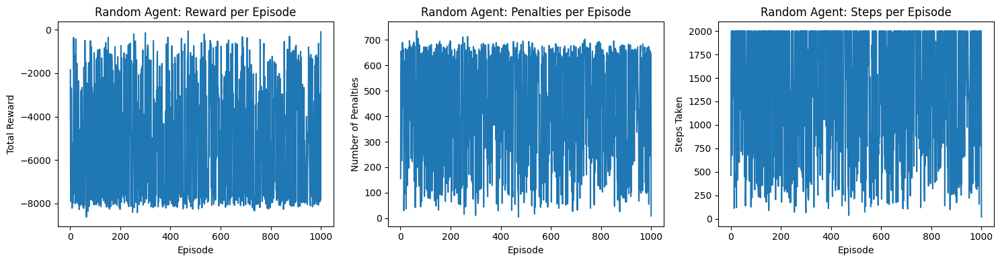

In [32]:
# Plotting the results of the Random Agent to show reward, penalties, and steps per episode and that its only guessing and not learning
episodes = np.arange(1, len(rewards) + 1)

plt.figure(figsize=(15, 4))

# Reward plot
plt.subplot(1, 3, 1)
plt.plot(episodes, rewards)
plt.xlabel("Episode")
plt.ylabel("Total Reward")
plt.title("Random Agent: Reward per Episode")

# Penalty plot
plt.subplot(1, 3, 2)
plt.plot(episodes, penalties)
plt.xlabel("Episode")
plt.ylabel("Number of Penalties")
plt.title("Random Agent: Penalties per Episode")

# Steps plot
plt.subplot(1, 3, 3)
plt.plot(episodes, steps)
plt.xlabel("Episode")
plt.ylabel("Steps Taken")
plt.title("Random Agent: Steps per Episode")

plt.tight_layout()
plt.show()


#### From the summary of the results, it shows that the random agent keeps guessing even if the previous one has a lesser reward and penalty

### Next we apply Reinforcement Learning to train an agent 

In [ ]:
#Setting ENVIRONMENT VARIABLES PARAMETERS AND STARTING STATE
MAX_STEPS = 2000
EPISODES = 1000
ALPHA = 0.01       # learning rate
GAMMA = 0.99      # discount factor
decay_rate = 0.0001 # Decay rate for exponential decay
max_epsilon = 1.0
min_epsilon = 0.01

# Q-learning parameters

decay_rate = 0.0001 # Decay rate for exponential decay
max_epsilon = 1.0
min_epsilon = 0.01

BoroTaxiNoRender = gym.make("Taxi-v3", max_episode_steps=MAX_STEPS)

print("ENVIRONMENT VARIABLES PARAMETERS COMPLETED WITH RANDOM STARTING STATE FOR EACH EPISODE\n")

ENVIRONMENT VARIABLES PARAMETERS COMPLETED WITH RANDOM STARTING STATE FOR EACH EPISODE



In [ ]:


# Initialize Q-table
state_size = BoroTaxiNoRender.observation_space.n
action_size = BoroTaxiNoRender.action_space.n
Q = np.zeros((state_size, action_size))


def Q_Agent(BoroTaxiNoRender, episodes, delay):
    rewards = []
    penalties = []
    steps_list = []

    

    

    for ep in range(episodes):
        # Exponential epsilon decay
        epsilon = min_epsilon + (max_epsilon - min_epsilon) * np.exp(-decay_rate * ep)

        if ep < episodes - 1:
            env = BoroTaxiNoRender
            mode = "No Render"
        else:
            BoroTaxiHumanRender = gym.make("Taxi-v3", render_mode="human", max_episode_steps=20)
            env = BoroTaxiHumanRender
            mode = "Human Render"

        state, _ = env.reset()
        #pygame.display.set_caption("AI Foundation Taxi Agent with Q-Learning Last Episode")

        done = False
        total_reward = 0
        penalty_count = 0
        steps = 0

        start_time = datetime.now()
        print(f"\nEpisode {ep+1}/{episodes} ({mode}) | Start: {start_time.strftime('%H:%M:%S')} | Epsilon: {epsilon:.4f}")

        while not done:
            if np.random.rand() < epsilon:
                action = env.action_space.sample()
            else:
                action = np.argmax(Q[state])

            next_state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated

            Q[state, action] += ALPHA * (reward + GAMMA * np.max(Q[next_state]) - Q[state, action])

            state = next_state
            total_reward += reward
            steps += 1
            if reward == -10:
                penalty_count += 1

            if mode == "Human Render":
                time.sleep(delay)

        end_time = datetime.now()
        print(f"End: {end_time.strftime('%H:%M:%S')} | Steps: {steps} | Reward: {total_reward} | Penalties: {penalty_count}")

        rewards.append(total_reward)
        penalties.append(penalty_count)
        steps_list.append(steps)

    BoroTaxiHumanRender.close()
    return rewards, penalties, steps_list



In [ ]:
rewards_q, penalties_q, steps_q = Q_Agent(
    BoroTaxiNoRender,
    episodes=100000,
    delay=0.5
)



Episode 1/100000 (No Render) | Start: 05:49:05 | Epsilon: 1.0000
End: 05:49:05 | Steps: 965 | Reward: -3662 | Penalties: 302

Episode 2/100000 (No Render) | Start: 05:49:05 | Epsilon: 0.9999
End: 05:49:05 | Steps: 666 | Reward: -2544 | Penalties: 211

Episode 3/100000 (No Render) | Start: 05:49:05 | Epsilon: 0.9998
End: 05:49:05 | Steps: 2000 | Reward: -7607 | Penalties: 623

Episode 4/100000 (No Render) | Start: 05:49:05 | Epsilon: 0.9997
End: 05:49:05 | Steps: 2000 | Reward: -7841 | Penalties: 649

Episode 5/100000 (No Render) | Start: 05:49:05 | Epsilon: 0.9996
End: 05:49:05 | Steps: 2000 | Reward: -7598 | Penalties: 622

Episode 6/100000 (No Render) | Start: 05:49:05 | Epsilon: 0.9995
End: 05:49:05 | Steps: 2000 | Reward: -7499 | Penalties: 611

Episode 7/100000 (No Render) | Start: 05:49:05 | Epsilon: 0.9994
End: 05:49:05 | Steps: 1339 | Reward: -5494 | Penalties: 464

Episode 8/100000 (No Render) | Start: 05:49:05 | Epsilon: 0.9993
End: 05:49:05 | Steps: 2000 | Reward: -7958 | P

Text(0.5, 1.0, 'Cummulative Reward per Episode - Q-Learning Agent')

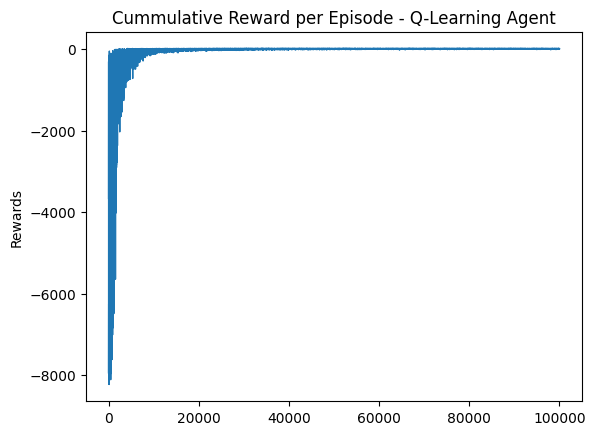

In [102]:
episodes = len(rewards_q)
x = np.arange(1, episodes + 1)
# Reward convergence
plt.plot(x, rewards_q, linewidth=1)
plt.ylabel("Rewards")
plt.title("Cummulative Reward per Episode - Q-Learning Agent")



Text(0, 0.5, 'Steps')

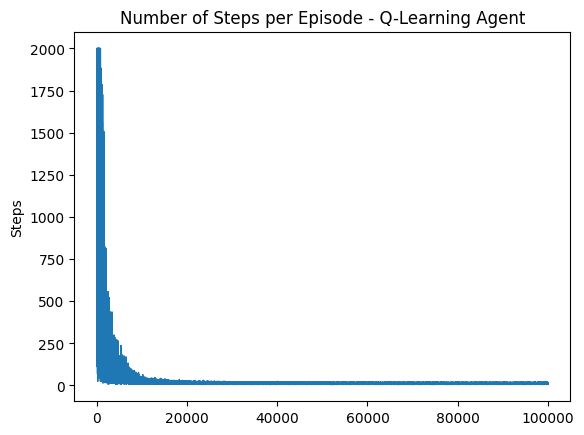

In [103]:

# Steps per episode
plt.plot(x, steps_q, linewidth=1)
plt.title("Number of Steps per Episode - Q-Learning Agent")
plt.ylabel("Steps")



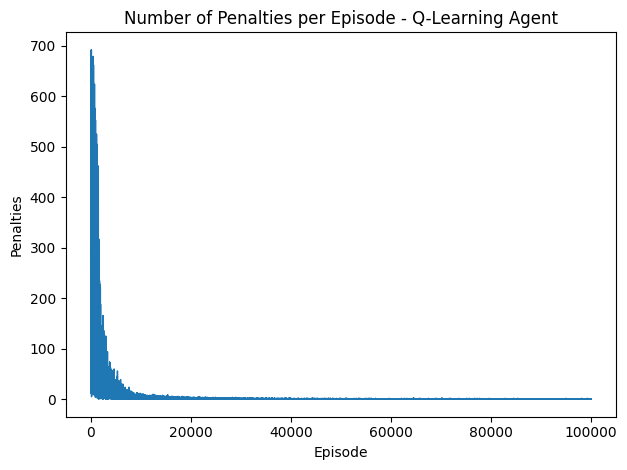

In [105]:
# Penalties per episode
plt.plot(x, penalties_q, linewidth=1)
plt.ylabel("Penalties")
plt.xlabel("Episode")
plt.title("Number of Penalties per Episode - Q-Learning Agent")
plt.tight_layout()
plt.show()

In [ ]:
# We Calculate the last 1000 episodes average performance to compare the the random agent performance
last_1000_rewards = rewards_q[-1000:]
avg_reward_q = np.mean(last_1000_rewards)
last_1000_penalties = penalties_q[-1000:]
avg_penalty_q = np.mean(last_1000_penalties)
last_1000_steps = steps_q[-1000:]
avg_steps_q = np.mean(last_1000_steps)
print("\n===== AVERAGE PERFORMANCE OVER LAST 1000 EPISODES - Q-LEARNING AGENT =====")
print(f"Average Reward   : {avg_reward_q:.2f}")
print(f"Average Penalties: {avg_penalty_q:.2f}")
print(f"Average Steps    : {avg_steps_q:.2f}")




===== AVERAGE PERFORMANCE OVER LAST 1000 EPISODES - Q-LEARNING AGENT =====
Average Reward   : 7.48
Average Penalties: 0.03
Average Steps    : 13.23


In [111]:


print("===== Random Agent =====")
print(f"Average Reward   : {np.mean(rewards):.2f}")
print(f"Average Steps    : {np.mean(steps):.2f}")
print(f"Average Penalties: {np.mean(penalties):.2f}")

print("\n===== Q-Learning Agent =====")
print(f"Average Reward   : {np.mean(avg_reward_q):.2f}")
print(f"Average Steps    : {np.mean(avg_steps_q):.2f}")
print(f"Average Penalties: {np.mean(avg_penalty_q):.2f}")



===== Random Agent =====
Average Reward   : -5220.34
Average Steps    : 1332.01
Average Penalties: 433.43

===== Q-Learning Agent =====
Average Reward   : 7.48
Average Steps    : 13.23
Average Penalties: 0.03


In [118]:

import pandas as pd
comparism = pd.DataFrame({"Agent": ["No Agent", "Q-learning Agent"],
                         "Average TimeStamp for the last 1000 Trip": [avg_steps, avg_steps_q],
                      "Average Rewards for the last 1000 Trip": [avg_reward, avg_reward_q],
                      "Average Penalties for the last 1000  Trip": [avg_penalty, avg_penalty_q]})

In [119]:
comparism

,Agent,Average TimeStamp for the last 1000 Trip,Average Rewards for the last 1000 Trip,Average Penalties for the last 1000 Trip
0,No Agent,1332.010,-49.44589,433.432
1,Q-learning Agent,13.231,7.48100,0.032


### Now we create a Test Environment to test the Q-Learning Agent

In [149]:
Q_learning_test = gym.make("Taxi-v3", render_mode="human")



In [150]:
#Greedy policy test functiondef greedy_policy_test(env, Q, episodes=1, delay=1.0):
def test_trained_agent(Q, Q_learning_test, episodes=10, delay=0.5):
    rewards = []
    penalties = []
    steps_list = []

    for ep in range(episodes):
        state, _ = Q_learning_test.reset()
        pygame.display.set_caption("AI Foundation ICA Testing Greedy Policy with Q-Learning Agent")
        done = False
        total_reward = 0
        penalty_count = 0
        steps = 0

        print(f"\nTest Episode {ep+1}")

        while not done:
            action = np.argmax(Q[state])  # Greedy action
            state, reward, terminated, truncated, _ = Q_learning_test.step(action)
            done = terminated or truncated

            total_reward += reward
            steps += 1
            if reward == -10:
                penalty_count += 1

            time.sleep(delay)

        print(f"Steps: {steps} | Reward: {total_reward} | Penalties: {penalty_count}")

        rewards.append(total_reward)
        penalties.append(penalty_count)
        steps_list.append(steps)

    Q_learning_test.close()
    return rewards, penalties, steps_list



In [151]:
test_rewards, test_penalties, test_steps = test_trained_agent(Q, Q_learning_test, episodes=10, delay=0.5)



Test Episode 1
Steps: 8 | Reward: 13 | Penalties: 0

Test Episode 2
Steps: 13 | Reward: 8 | Penalties: 0

Test Episode 3
Steps: 10 | Reward: 11 | Penalties: 0

Test Episode 4
Steps: 12 | Reward: 9 | Penalties: 0

Test Episode 5
Steps: 10 | Reward: 11 | Penalties: 0

Test Episode 6
Steps: 15 | Reward: 6 | Penalties: 0

Test Episode 7
Steps: 12 | Reward: 9 | Penalties: 0

Test Episode 8
Steps: 15 | Reward: 6 | Penalties: 0

Test Episode 9
Steps: 12 | Reward: 9 | Penalties: 0

Test Episode 10
Steps: 15 | Reward: 6 | Penalties: 0


In [152]:
print("\n===== TEST RESULTS =====")
print(f"Average Reward   : {np.mean(test_rewards):.2f}")
print(f"Average Steps    : {np.mean(test_steps):.2f}")
print(f"Average Penalties: {np.mean(test_penalties):.2f}")
print(f"Success Rate     : {sum(p == 0 for p in test_penalties) / len(test_penalties) * 100:.1f}%")



===== TEST RESULTS =====
Average Reward   : 8.80
Average Steps    : 12.20
Average Penalties: 0.00
Success Rate     : 100.0%


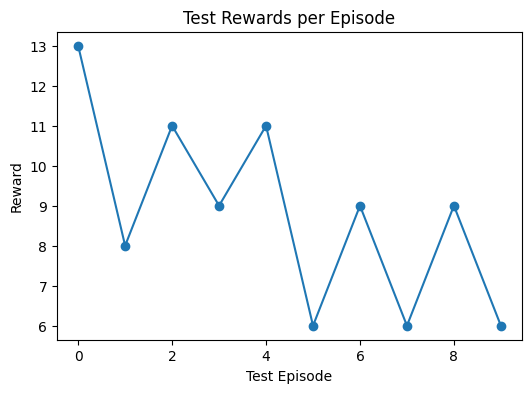

In [153]:
plt.figure(figsize=(6,4))
plt.plot(test_rewards, marker='o')
plt.xlabel("Test Episode")
plt.ylabel("Reward")
plt.title("Test Rewards per Episode")
plt.show()


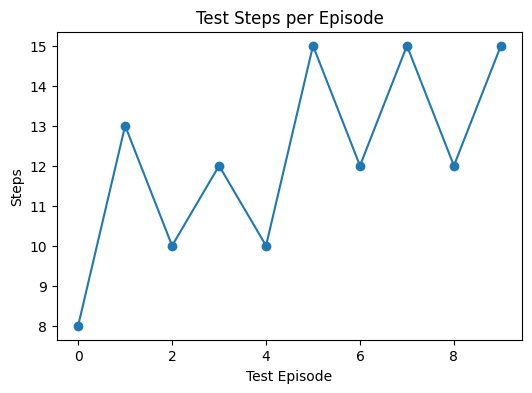

In [154]:
plt.figure(figsize=(6,4))
plt.plot(test_steps, marker='o')
plt.xlabel("Test Episode")
plt.ylabel("Steps")
plt.title("Test Steps per Episode")
plt.show()


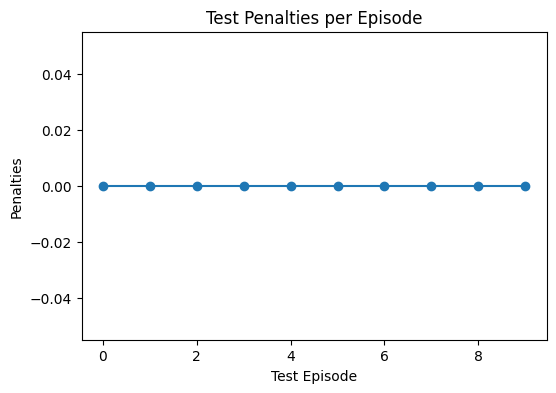

In [155]:
plt.figure(figsize=(6,4))
plt.plot(test_penalties, marker='o')
plt.xlabel("Test Episode")
plt.ylabel("Penalties")
plt.title("Test Penalties per Episode")
plt.show()


#### Now I am going to use the SARSA ALGORITHM

In [184]:
#SARSA INITIALIZATION


state_size = BoroTaxiNoRender.observation_space.n
action_size = BoroTaxiNoRender.action_space.n

print("STATE SIZE:", state_size)
print("ACTION SIZE:", action_size)





STATE SIZE: 500
ACTION SIZE: 6


#### I did the same with SARSA because it takes time to train, I train without render and only render the last one to see how the agent performed

In [185]:
# Initialize SARSA Q-table
Q_sarsa = np.zeros((state_size, action_size))
Q_sarsa

array([[0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0.],
       ...,
       [0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0.]], shape=(500, 6))

In [ ]:
#The same hyperparameters as Q-learning are used to train the SARSA agent


def Sarsa_Agent(BoroTaxiNoRender, episodes, delay):
    rewards = []
    penalties = []
    steps_list = []

    for ep in range(episodes):
        # Exponential epsilon decay
        epsilon = min_epsilon + (max_epsilon - min_epsilon) * np.exp(-decay_rate * ep)

        if ep < episodes - 1:
            env = BoroTaxiNoRender
            mode = "No Render"
        else:
            BoroTaxiHumanRender = gym.make("Taxi-v3", render_mode="human", max_episode_steps=20)
            env = BoroTaxiHumanRender
            mode = "Human Render"

        state, _ = env.reset()
        pygame.display.set_caption("AI Foundation Taxi Agent with SARSA Last Episode")

        # Choose initial action (on-policy)
        if np.random.rand() < epsilon:
            action = env.action_space.sample()
        else:
            action = np.argmax(Q_sarsa[state])

        done = False
        total_reward = 0
        penalty_count = 0
        steps = 0

        start_time = datetime.now()
        print(f"\nEpisode {ep+1}/{episodes} ({mode}) | Start: {start_time.strftime('%H:%M:%S')} | Epsilon: {epsilon:.4f}")

        while not done:
            next_state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated

            # Choose next action (on-policy)
            if np.random.rand() < epsilon:
                next_action = env.action_space.sample()
            else:
                next_action = np.argmax(Q_sarsa[next_state])

            # SARSA update
            Q_sarsa[state, action] += ALPHA * (
                reward + GAMMA * Q_sarsa[next_state, next_action] - Q_sarsa[state, action]
            )

            state = next_state
            action = next_action

            total_reward += reward
            steps += 1
            if reward == -10:
                penalty_count += 1

            if mode == "Human Render":
                time.sleep(delay)

        end_time = datetime.now()
        print(f"End: {end_time.strftime('%H:%M:%S')} | Steps: {steps} | Reward: {total_reward} | Penalties: {penalty_count}")

        rewards.append(total_reward)
        penalties.append(penalty_count)
        steps_list.append(steps)

        if mode == "Human Render":
            env.close()

    return rewards, penalties, steps_list


In [ ]:
rewards_sarsa, penalties_sarsa, steps_sarsa = Sarsa_Agent(
    BoroTaxiNoRender,
    episodes=100000, #number of episodes
    delay=0.5
)



Episode 1/100000 (No Render) | Start: 07:06:10 | Epsilon: 1.0000
End: 07:06:10 | Steps: 341 | Reward: -1256 | Penalties: 104

Episode 2/100000 (No Render) | Start: 07:06:10 | Epsilon: 0.9999
End: 07:06:10 | Steps: 1489 | Reward: -5914 | Penalties: 494

Episode 3/100000 (No Render) | Start: 07:06:10 | Epsilon: 0.9998
End: 07:06:10 | Steps: 2000 | Reward: -7805 | Penalties: 645

Episode 4/100000 (No Render) | Start: 07:06:10 | Epsilon: 0.9997
End: 07:06:10 | Steps: 184 | Reward: -694 | Penalties: 59

Episode 5/100000 (No Render) | Start: 07:06:10 | Epsilon: 0.9996
End: 07:06:10 | Steps: 726 | Reward: -2775 | Penalties: 230

Episode 6/100000 (No Render) | Start: 07:06:10 | Epsilon: 0.9995
End: 07:06:11 | Steps: 2000 | Reward: -7859 | Penalties: 651

Episode 7/100000 (No Render) | Start: 07:06:11 | Epsilon: 0.9994
End: 07:06:11 | Steps: 538 | Reward: -2011 | Penalties: 166

Episode 8/100000 (No Render) | Start: 07:06:11 | Epsilon: 0.9993
End: 07:06:11 | Steps: 359 | Reward: -1652 | Penalt

In [188]:
Q_sarsa

array([[  0.        ,   0.        ,   0.        ,   0.        ,
          0.        ,   0.        ],
       [-20.57008626, -22.91167857, -23.69469661, -20.65947783,
          8.14346964, -28.2402253 ],
       [-16.92001107, -10.26554166, -20.20171378, -15.18701222,
         13.58668515, -23.71204082],
       ...,
       [ -9.71546325,  14.76104791,  -7.95176384, -10.33660369,
        -14.55505362, -15.49124109],
       [-30.78400636, -27.97541216, -30.85014644, -30.72217052,
        -37.94576515, -37.8307232 ],
       [  6.99188012,   2.10038153,   5.6656108 ,  18.63968943,
         -2.79079205,  -0.88147091]], shape=(500, 6))

Text(0.5, 1.0, 'Cummulative Reward per Episode - SARSA Agent')

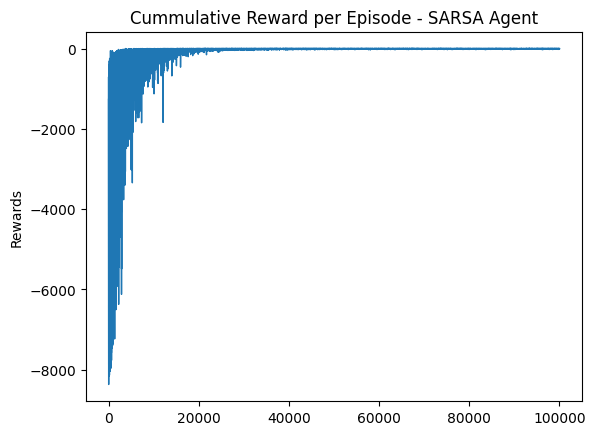

In [189]:
episodes = len(rewards_sarsa)
x = np.arange(1, episodes + 1)
# Reward convergence
plt.plot(x, rewards_sarsa, linewidth=1)
plt.ylabel("Rewards")
plt.title("Cummulative Reward per Episode - SARSA Agent")

Text(0, 0.5, 'Steps')

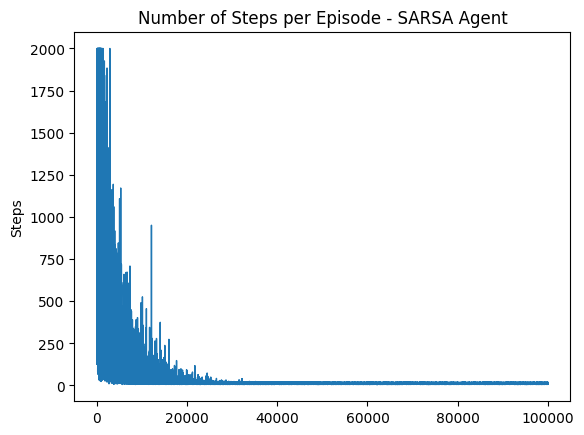

In [191]:

# Steps per episode
plt.plot(x, steps_sarsa, linewidth=1)
plt.title("Number of Steps per Episode - SARSA Agent")
plt.ylabel("Steps")



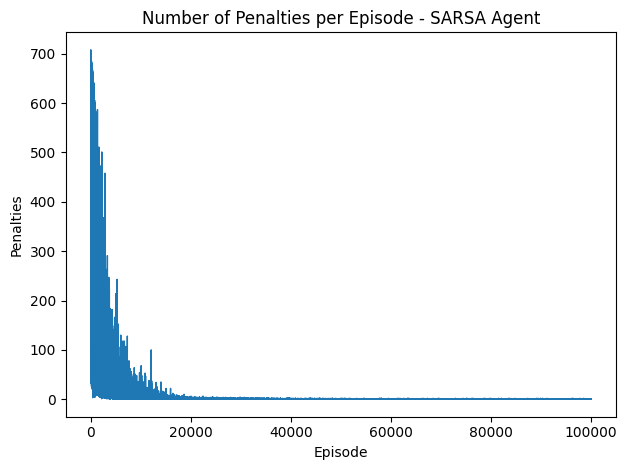

In [193]:
# Penalties per episode
plt.plot(x, penalties_sarsa, linewidth=1)
plt.ylabel("Penalties")
plt.xlabel("Episode")
plt.title("Number of Penalties per Episode - SARSA Agent")
plt.tight_layout()
plt.show()

In [ ]:



# We Calculate the last 1000 episodes average performance to compare the the random agent performance
last_1000_rewards_sarsa = rewards_sarsa[-1000:]
avg_reward_sarsa = np.mean(last_1000_rewards_sarsa)
last_1000_penalties_sarsa = penalties_sarsa[-1000:]
avg_penalty_sarsa = np.mean(last_1000_penalties_sarsa)
last_1000_steps_sarsa = steps_sarsa[-1000:]
avg_steps_sarsa = np.mean(last_1000_steps_sarsa)
print("\n===== AVERAGE PERFORMANCE OVER LAST 1000 EPISODES - SARSA AGENT =====")
print(f"Average Reward   : {avg_reward_sarsa:.2f}")
print(f"Average Penalties: {avg_penalty_sarsa:.2f}")
print(f"Average Steps    : {avg_steps_sarsa:.2f}")



===== AVERAGE PERFORMANCE OVER LAST 1000 EPISODES - SARSA AGENT =====
Average Reward   : 7.53
Average Penalties: 0.04
Average Steps    : 13.14


In [ ]:
print("===== Random Agent =====")
print(f"Average Reward   : {np.mean(rewards):.2f}")
print(f"Average Steps    : {np.mean(steps):.2f}")
print(f"Average Penalties: {np.mean(penalties):.2f}")

print("\n===== Q-Learning Agent =====")
print(f"Average Reward   : {np.mean(avg_reward_q):.2f}")
print(f"Average Steps    : {np.mean(avg_steps_q):.2f}")
print(f"Average Penalties: {np.mean(avg_penalty_q):.2f}")

print("\n===== SARSA Agent =====")
print(f"Average Reward   : {np.mean(avg_reward_sarsa):.2f}")
print(f"Average Steps    : {np.mean(avg_steps_sarsa):.2f}")
print(f"Average Penalties: {np.mean(avg_penalty_sarsa):.2f}")



===== Random Agent =====
Average Reward   : -5220.34
Average Steps    : 1332.01
Average Penalties: 433.43

===== Q-Learning Agent =====
Average Reward   : 7.48
Average Steps    : 13.23
Average Penalties: 0.03

===== SARSA Agent =====
Average Reward   : 7.53
Average Steps    : 13.14
Average Penalties: 0.04


In [224]:
comparism_with_sarsa = pd.DataFrame({"Agent": ["No Agent", "Q-learning Agent", "SARSA Agent"],
                         "Average TimeStamp for the last 1000 Trip": [avg_steps, avg_steps_q, avg_steps_sarsa],
                      "Average Rewards for the last 1000 Trip": [avg_reward, avg_reward_q, avg_reward_sarsa],
                      "Average Penalties for the last 1000  Trip": [avg_penalty, avg_penalty_q, avg_penalty_sarsa]})

In [225]:
comparism_with_sarsa

,Agent,Average TimeStamp for the last 1000 Trip,Average Rewards for the last 1000 Trip,Average Penalties for the last 1000 Trip
0,No Agent,1332.010,-49.44589,433.432
1,Q-learning Agent,13.231,7.48100,0.032
2,SARSA Agent,13.139,7.52800,0.037


### Now we Test / Evaluate the SARSA Agent

In [231]:
sarsa_test_env = gym.make("Taxi-v3", render_mode="human")


In [233]:
def test_sarsa_agent(Q_sarsa, sarsa_test_env, episodes=10, delay=0.5):
    rewards = []
    penalties = []
    steps_list = []

    for ep in range(episodes):
        state, _ = sarsa_test_env.reset()
        pygame.display.set_caption("AI Foundation SARSA Testing Agent")
        done = False
        total_reward = 0
        penalty_count = 0
        steps = 0

        print(f"\nTest Episode {ep+1}")

        while not done:
            action = np.argmax(Q_sarsa[state])  # Greedy policy
            state, reward, terminated, truncated, _ = sarsa_test_env.step(action)
            done = terminated or truncated

            total_reward += reward
            steps += 1
            if reward == -10:
                penalty_count += 1

            time.sleep(delay)

        print(f"Steps: {steps} | Reward: {total_reward} | Penalties: {penalty_count}")

        rewards.append(total_reward)
        penalties.append(penalty_count)
        steps_list.append(steps)

    sarsa_test_env.close()
    return rewards, penalties, steps_list


In [234]:
test_rewards_sarsa, test_penalties_sarsa, test_steps_sarsa = test_sarsa_agent(
    Q_sarsa,
    sarsa_test_env,
    episodes=10,
    delay=0.5
)



Test Episode 1
Steps: 15 | Reward: 6 | Penalties: 0

Test Episode 2
Steps: 17 | Reward: 4 | Penalties: 0

Test Episode 3
Steps: 13 | Reward: 8 | Penalties: 0

Test Episode 4
Steps: 12 | Reward: 9 | Penalties: 0

Test Episode 5
Steps: 9 | Reward: 12 | Penalties: 0

Test Episode 6
Steps: 17 | Reward: 4 | Penalties: 0

Test Episode 7
Steps: 15 | Reward: 6 | Penalties: 0

Test Episode 8
Steps: 14 | Reward: 7 | Penalties: 0

Test Episode 9
Steps: 14 | Reward: 7 | Penalties: 0

Test Episode 10
Steps: 16 | Reward: 5 | Penalties: 0


In [ ]:
print("\n===== TEST RESULTS =====")
print(f"Average Reward   : {np.mean(test_rewards_sarsa):.2f}")
print(f"Average Steps    : {np.mean(test_steps_sarsa):.2f}")
print(f"Average Penalties: {np.mean(test_penalties_sarsa):.2f}")
print(f"Success Rate     : {sum(p == 0 for p in test_penalties_sarsa) / len(test_penalties_sarsa) * 100:.1f}%")


===== TEST RESULTS =====
Average Reward   : 6.80
Average Steps    : 14.20
Average Penalties: 0.00
Success Rate     : 100.0%


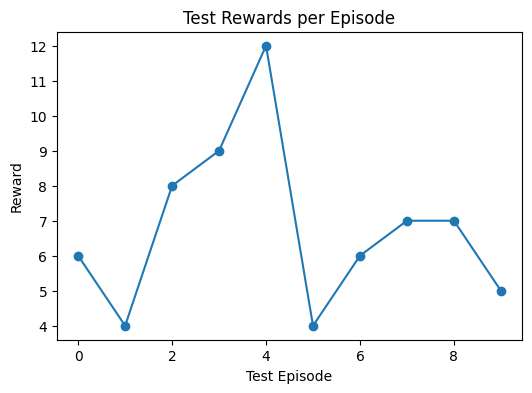

In [236]:
plt.figure(figsize=(6,4))
plt.plot(test_rewards_sarsa, marker='o')
plt.xlabel("Test Episode")
plt.ylabel("Reward")
plt.title("Test Rewards per Episode")
plt.show()


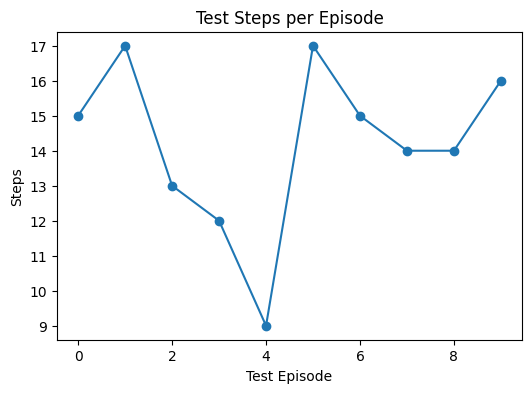

In [ ]:
plt.figure(figsize=(6,4))
plt.plot(test_steps_sarsa, marker='o')
plt.xlabel("Test Episode")
plt.ylabel("Steps")
plt.title("Test Steps per Episode")
plt.show()


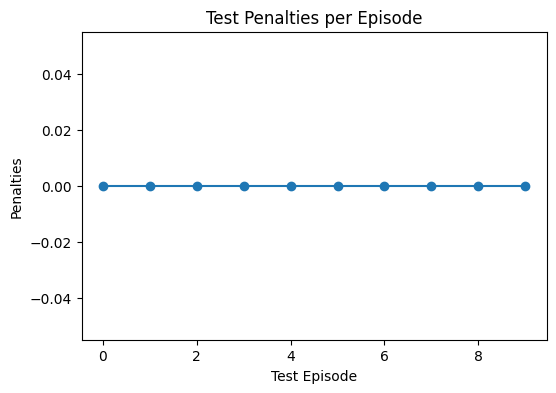

In [238]:
plt.figure(figsize=(6,4))
plt.plot(test_penalties_sarsa, marker='o')
plt.xlabel("Test Episode")
plt.ylabel("Penalties")
plt.title("Test Penalties per Episode")
plt.show()


#### Comparism betweeen the Q-AGENT and the SARSA AGENT

In [241]:
q_agent_with_sarsa_agent = pd.DataFrame({"Agent": ["Q-learning Agent", "SARSA Agent"],
                         "Average Test Timestamp over 10 Testing Trips": [f"{np.mean(test_steps):.2f}", f"{np.mean(test_steps_sarsa):.2f}"],
                      "Average Test Rewards over 10 Testing Trips": [f"{np.mean(test_rewards):.2f}", f"{np.mean(test_rewards_sarsa):.2f}"],
                      "Average Test Penalties over 10 Testing Trips": [f"{np.mean(test_penalties):.2f}", f"{np.mean(test_penalties_sarsa):.2f}"]})




In [242]:
q_agent_with_sarsa_agent

,Agent,Average Test Timestamp over 10 Testing Trips,Average Test Rewards over 10 Testing Trips,Average Test Penalties over 10 Testing Trips
0,Q-learning Agent,12.20,8.80,0.00
1,SARSA Agent,14.20,6.80,0.00


#### This shows that The Q-Agent performs slightly better than the SARSA AGENT

In [243]:


avg_steps = np.mean(steps)
avg_steps_q = np.mean(steps_q)
avg_steps_sarsa = np.mean(steps_sarsa)  


In [245]:
print("===== Random Agent =====")
print(f"Average Steps    : {np.mean(steps):.2f}")

print("\n===== Q-Learning Agent =====")
print(f"Average Steps    : {np.mean(avg_steps_q):.2f}")

print("\n===== SARSA Agent =====")
print(f"Average Steps    : {np.mean(avg_steps_sarsa):.2f}")


===== Random Agent =====
Average Steps    : 1332.01

===== Q-Learning Agent =====
Average Steps    : 28.63

===== SARSA Agent =====
Average Steps    : 37.37


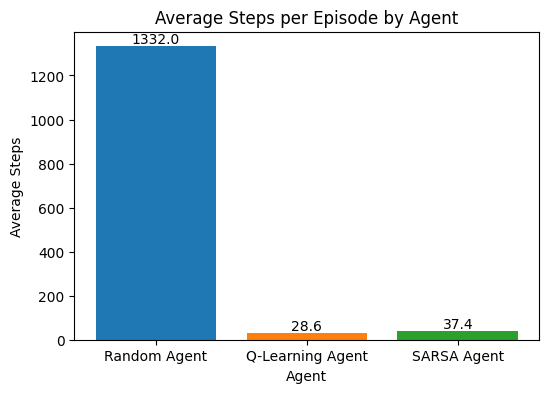

In [249]:
agents = ["Random Agent", "Q-Learning Agent", "SARSA Agent"]
avg_steps = [
    np.mean(steps),
    np.mean(avg_steps_q),
    np.mean(avg_steps_sarsa)
]

colors = ["tab:blue", "tab:orange", "tab:green"]

plt.figure(figsize=(6,4))
bars = plt.bar(agents, avg_steps, color=colors)

plt.title("Average Steps per Episode by Agent")
plt.ylabel("Average Steps")
plt.xlabel("Agent")

# Add value labels on top of bars
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f"{height:.1f}",
        ha="center",
        va="bottom"
    )

plt.show()
